<a href="https://colab.research.google.com/github/jalbert90/Image-to-Image/blob/colab/Image_to_Image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Description:** Extract images.  

**Notes:**
1. Will (probably) have to change this for Kaggle implementation.

In [ ]:
# Silent
%%capture
!unzip '/content/Image_to_Image.zip'

**Description:** Load images into datasets.

**Notes:**
1. Possibly clean this up somehow.
2. Also, directories will be different over on Kaggle.

In [ ]:
import tensorflow as tf

image_size = (512, 512)

X_train_ = tf.keras.utils.image_dataset_from_directory(
    '/content/Image_to_Image/isosurface',
    batch_size=None,
    labels=None,
    image_size=image_size,
    validation_split=0.25,
    subset='training',
    seed=0,
)

X_test_ = tf.keras.utils.image_dataset_from_directory(
    '/content/Image_to_Image/isosurface',
    batch_size=None,
    labels=None,
    image_size=image_size,
    validation_split=0.25,
    subset='validation',
    seed=0,
)

Y_train_ = tf.keras.utils.image_dataset_from_directory(
    '/content/Image_to_Image/transparency',
    batch_size=None,
    labels=None,
    image_size=image_size,
    validation_split=0.25,
    subset='training',
    seed=0,
)

Y_test_ = tf.keras.utils.image_dataset_from_directory(
    '/content/Image_to_Image/transparency',
    batch_size=None,
    labels=None,
    image_size=image_size,
    validation_split=0.25,
    subset='validation',
    seed=0,
)

Found 32 files belonging to 1 classes.
Using 24 files for training.
Found 32 files belonging to 1 classes.
Using 8 files for validation.
Found 32 files belonging to 1 classes.
Using 24 files for training.
Found 32 files belonging to 1 classes.
Using 8 files for validation.


Confirming that type is dataset:

In [ ]:
%%script true

display(X_train_)
X_train_.cardinality()

In [ ]:
from math import floor

AUTOTUNE = tf.data.AUTOTUNE
BUFFER_SIZE = 1000
BATCH_SIZE = 1
IMG_WIDTH = 128
IMG_HEIGHT = 128

def normalize(image):
  image = tf.image.convert_image_dtype(image, dtype=tf.float32)
  return (image - 127.5) / 127.5

def normalize2(image):
  image = tf.image.convert_image_dtype(image, dtype=tf.float32)
  return tf.divide(
      tf.subtract(
          image, tf.reduce_min(image)
      ),
      tf.subtract(
          tf.reduce_max(image), tf.reduce_min(image)
      )
  )

def random_jitter(image):
  image = tf.image.resize(image, (IMG_WIDTH + floor(IMG_WIDTH * 0.12), IMG_HEIGHT + floor(IMG_HEIGHT * 0.12)), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  image = tf.image.random_crop(image, (IMG_WIDTH, IMG_HEIGHT, 3))
  image = tf.image.random_flip_left_right(image)
  return image

def preprocess_train(image):
  image = random_jitter(image)
  image = normalize(image)
  return image

def preprocess_test(image):
  image = tf.image.resize(image, size=(IMG_WIDTH, IMG_HEIGHT), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  image = normalize(image)
  return image

def resize(image):
  image = tf.image.resize(image, size=(IMG_WIDTH, IMG_HEIGHT), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return image

In [ ]:
x_1 = next(iter(X_train_))
y_1 = next(iter(Y_train_))

In [ ]:
import matplotlib.pyplot as plt

def show_images(images, rows, columns):
  image_list = []
  for image in images:
    image_list.append((image + 1)/2)

  for i in range(rows):
    for j in range(columns):
      plt.subplot(rows, columns, i+j+1)
      plt.imshow(image_list[i+j])

In [ ]:
%%script true

show_images((x_1, y_1), 1, 2)

In [ ]:
x_1_n = normalize(x_1)
y_1_n = normalize(y_1)

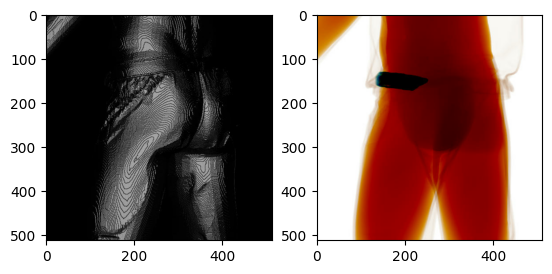

In [ ]:
# %%script true

show_images((x_1_n, y_1_n), 1, 2)

In [ ]:
x_1_test = preprocess_test(x_1)
y_1_test = preprocess_test(y_1)

x_1_test = sample_iso = tf.expand_dims(x_1_test, 0)
y_1_test = sample_tran = tf.expand_dims(y_1_test, 0)

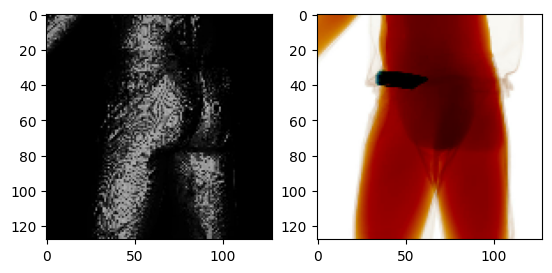

In [ ]:
# %%script true

show_images((x_1_test[0], y_1_test[0]), 1, 2)

In [ ]:
x_1_train = preprocess_train(x_1)
y_1_train = preprocess_train(y_1)

x_1_train = tf.expand_dims(x_1_train, 0)
y_1_train = tf.expand_dims(y_1_train, 0)

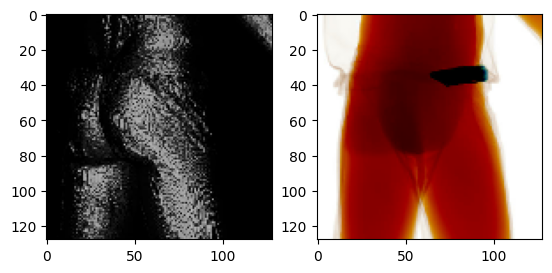

In [ ]:
# %%script true

show_images((x_1_train[0], y_1_train[0]), 1, 2)

In [ ]:
def augment_dataset(dataset, num_copies):
  image_list = []
  for image in dataset:
    image = normalize(image)
    image_list.append(tf.image.resize(image, size=(IMG_WIDTH, IMG_HEIGHT), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR))
    for i in range(num_copies):
      new_image = random_jitter(image)
      image_list.append(new_image)

  image_stack = tf.stack(image_list)
  augmented_dataset = tf.data.Dataset.from_tensor_slices(image_stack)
  return augmented_dataset

In [ ]:
X_train = augment_dataset(X_train_, 1)
Y_train = augment_dataset(Y_train_, 1)

In [ ]:
display(X_train_)
display(X_train_.cardinality())
display(X_train)
display(X_train.cardinality())

<_PrefetchDataset element_spec=TensorSpec(shape=(512, 512, 3), dtype=tf.float32, name=None)>

<tf.Tensor: shape=(), dtype=int64, numpy=24>

<_TensorSliceDataset element_spec=TensorSpec(shape=(128, 128, 3), dtype=tf.float32, name=None)>

<tf.Tensor: shape=(), dtype=int64, numpy=48>

In [ ]:
%%script true

plt.figure(figsize=(30,10))
sample_it = iter(X_train)
for i in range(10):
  sample = next(sample_it)
  plt.subplot(2, 5, i+1)
  plt.imshow(sample*0.5 + 0.5)

In [ ]:
%%script true

plt.figure(figsize=(30,10))
sample_it = iter(Y_train)
for i in range(10):
  sample = next(sample_it)
  plt.subplot(2, 5, i+1)
  plt.imshow(sample*0.5 + 0.5)

In [ ]:
X_train = X_train.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
Y_train = Y_train.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

X_test = X_test_.map(preprocess_test).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
Y_test = Y_test_.map(preprocess_test).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

Import Keras directly to avoid these issues:

- https://github.com/tensorflow/tensorflow/issues/53144
- https://github.com/tensorflow/tensorflow/issues/56231

In [ ]:
import keras
from keras import layers

**Description:** Functional API: Construct generator model.

**Notes:**

1. Comments are all wrong about the shapes.
    - Should be (None, 512, 512, 3), not (512, 512, 3). I don't 100% understand this, but I fixed it by batching my images in batches of 1, so it must have something to do with that.

https://arxiv.org/pdf/1703.10593.pdf

In [ ]:
def build_generator():
  input_tensor = keras.Input(shape=(IMG_WIDTH, IMG_HEIGHT, 3))

  initilizer = keras.initializers.RandomNormal(0, 0.05)

  t = layers.Conv2D(64, 7, strides=1, padding='same', kernel_initializer=initilizer)(input_tensor)
  t = layers.BatchNormalization()(t)
  t = layers.Activation('leaky_relu')(t)

  # Downsample:

  t = layers.Conv2D(128, 3, strides=2, padding='same', kernel_initializer=initilizer)(t)
  t = layers.Activation('leaky_relu')(t)

  t = layers.Conv2D(256, 3, strides=2, padding='same', kernel_initializer=initilizer)(t)
  t = layers.BatchNormalization()(t)
  t = layers.Activation('leaky_relu')(t)

  # Residule (to retain features):
  for i in range(6):
    retain = t

    t = layers.Conv2D(256, 3, strides=1, padding='same', kernel_initializer=initilizer)(t)
    t = layers.BatchNormalization()(t)
    t = layers.Activation('leaky_relu')(t)
    t = layers.Conv2D(256, 3, strides=1, padding='same', kernel_initializer=initilizer)(t)
    t = layers.BatchNormalization()(t)

    # Skip connection
    t = tf.add(t, retain)
    t = layers.Activation('relu')(t)

  # Upsample:
  t = layers.Conv2DTranspose(128, 3, strides=2, padding='same', kernel_initializer=initilizer)(t)
  t = layers.BatchNormalization()(t)
  t = layers.Activation('leaky_relu')(t)

  t = layers.Conv2DTranspose(64, 3, strides=2, padding='same', kernel_initializer=initilizer)(t)
  t = layers.BatchNormalization()(t)
  t = layers.Activation('leaky_relu')(t)

  output_tensor = layers.Conv2D(3, 7, strides=1, padding='same', activation='tanh', kernel_initializer=initilizer)(t)

  return keras.Model(inputs=input_tensor, outputs=output_tensor)

**Description:** Functional API: Construct discriminator model.

**Notes:**
1. Change $x$ to $t$ for clarity (since $x$ is later used as an element in $X$).
2. Comments are all wrong about the shapes.
    - Should be (None, 512, 512, 3), not (512, 512, 3). I don't 100% understand this, but I fixed it by batching my images in batches of 1, so it must have something to do with that.

In [ ]:
def build_discriminator():
  input = keras.Input(shape=(IMG_WIDTH, IMG_HEIGHT, 3))

  initilizer = keras.initializers.RandomNormal(0, 0.05)

  t = layers.Conv2D(64, 4, strides=2, padding='same', kernel_initializer=initilizer)(input)
  t = layers.Activation('leaky_relu')(t)

  t = layers.Conv2D(128, 4, strides=2, padding='same', kernel_initializer=initilizer)(input)
  t = layers.BatchNormalization()(t)
  t = layers.Activation('leaky_relu')(t)

  t = layers.Conv2D(256, 4, strides=2, padding='same', kernel_initializer=initilizer)(input)
  t = layers.BatchNormalization()(t)
  t = layers.Activation('leaky_relu')(t)

  t = layers.Conv2D(512, 4, strides=2, padding='same', kernel_initializer=initilizer)(input)
  t = layers.BatchNormalization()(t)
  t = layers.Activation('leaky_relu')(t)

  t = layers.Flatten()(t)

  t = layers.Dense(32)(t)
  t = layers.Activation('leaky_relu')(t)
  output = layers.Dense(1, activation='sigmoid')(t)

  return keras.Model(inputs=input, outputs=output)

**Description:** Construct generators and discriminators.

**Notes:**
1. I seem to be using a lot of RAM here. Might be an issue since Colab only allows limited memory.

---

Domains and Functions
---

$X =$ Isosurface Domain  
$Y =$ Transparency Domain

Iso to Tran generator:  
$\quad G \colon X \to Y$  
Tran to Iso generator:  
$\quad F \colon Y \to X$  
Tran discriminator:  
$\quad D \colon Y \to [0, 1]$  
Iso discriminator:  
$\quad C \colon X \to [0, 1]$

---

$
D(y) =
\begin{cases}
    1 \qquad \text{real according to D} \\
    \vdots \\
    0 \qquad \text{fake according to D}
\end{cases}
$

### Description:
Create an optimizer object for each loss function

### Notes:

1. The Adam optimizer is a stochastic gradient descent algorithm.
2. Adjust parameters later.

In [ ]:
def compiler(gamma=0.001):
  G = Iso_To_Tran = build_generator()
  F = Tran_To_Iso = build_generator()
  C = Iso_D = build_discriminator()
  D = Tran_D = build_discriminator()

  G_optimizer = tf.keras.optimizers.Adam(learning_rate=gamma)
  F_optimizer = tf.keras.optimizers.Adam(learning_rate=gamma)
  D_optimizer = tf.keras.optimizers.Adam(learning_rate=gamma)
  C_optimizer = tf.keras.optimizers.Adam(learning_rate=gamma)

  return G, F, C, D, G_optimizer, F_optimizer, D_optimizer, C_optimizer

In [ ]:
G, F, C, D, G_optimizer, F_optimizer, D_optimizer, C_optimizer = compiler(0.0002)

In [ ]:
gamma = 0.01
D = build_discriminator()
D_optimizer = tf.keras.optimizers.Adam(learning_rate=gamma)

G = build_generator()

In [ ]:
# G.save_weights('G')
# F.save_weights('F')
# C.save_weights('C')
# D.save_weights('D')

In [ ]:
# G.reset_states()
# F.reset_states()
# C.reset_states()
# D.reset_states()

**Description:** Function to display a generator input and output SxS.

**Notes:**
1. No titles present.

In [ ]:
def generate_image(generator, input_image):
  output_image = generator(input_image)

  image_list = [input_image[0], output_image[0]]

  # show_images(image_list, 1, 2)
  # plt.show()

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.imshow(image_list[i]*0.5+0.5)
  plt.show()

In [ ]:
# G.load_weights('G')
# F.load_weights('F')
# C.load_weights('C')
# D.load_weights('D')

Test image generation function:

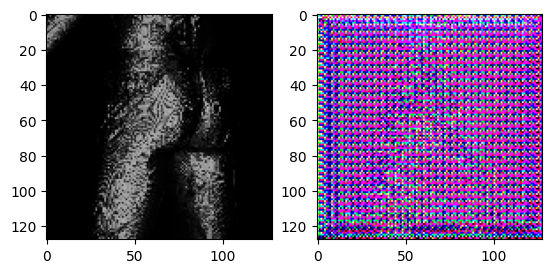

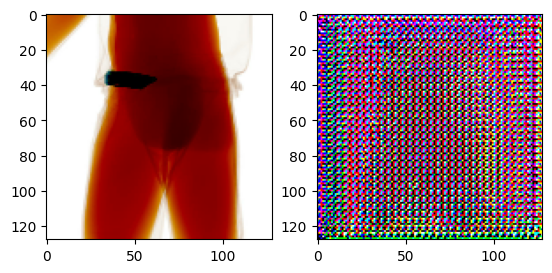

In [ ]:
generate_image(G, x_1_test)
generate_image(F, y_1_test)

**Description:** Binary Cross Entropy explanation.

- bce $= -\log(\text{probability that output is target})$.
    - Take the average of this if you have multiple values.

Snippet from Keras backend API (https://github.com/keras-team/keras/blob/v2.15.0/keras/backend.py):

```python
    # ...
    # Compute cross entropy from probabilities.
    bce = target * tf.math.log(output + epsilon())
    bce += (1 - target) * tf.math.log(1 - output + epsilon())
    return -bce
```

In [ ]:
# Create instance of BinaryCrossentropy class:
bce = tf.keras.losses.BinaryCrossentropy()

**Description:** Define loss functions

**Notes:**
1. `disc_gen` = $D(G(x))$ or $C(F(y))$ (discriminator applied to generated image).
    - If `disc_gen` is close to 1, discriminator was fooled and generator loss is low.
    - If `disc_gen` is close to 0, discriminator wasn't fooled and generator loss is high.
2. `real` = $x$ or $y$.
3. `cycled` = $F(G(x))$ or $G(F(y))$.
    - If `cycled` is close to `real`, generators did a good job and cycle loss is low.
4. `identity` = $F(x)$ or $G(y)$.
    - If $x \approx F(x)$ or $y \approx G(y)$, generator preserved identity of input and identity loss is low.
5. `disc_real` = $D(y)$ or $D(x)$.
    - `disc_real` close to 1 => loss low.
    - `disc_gen` close to 0 => loss low.

- **Missing some scaling factors.**

In [ ]:
LAMDA = 10

def generator_loss(disc_gen):
  return bce(tf.ones_like(disc_gen), disc_gen)

def cycle_loss(real, cycled):
  return tf.reduce_mean(tf.abs(real - cycled)) * LAMDA

def identity_loss(real, identity):
  return tf.reduce_mean(tf.abs(real - identity)) * LAMDA * 0.5

def discriminator_loss(disc_real, disc_gen):
  real_loss = bce(tf.ones_like(disc_real), disc_real)   # Target is 1
  gen_loss = bce(tf.zeros_like(disc_gen), disc_gen)     # Target is 0

  return (real_loss + gen_loss) / 2                     # Average loss

D = Y discriminator

In [ ]:
@tf.function
def D_test(x, y):
  with tf.GradientTape(persistent=True) as tape:
    fake_y = G(x)
    D_loss = discriminator_loss(D(y), D(fake_y))

  D_grads = tape.gradient(D_loss, D.trainable_variables)
  D_optimizer.apply_gradients(zip(D_grads, D.trainable_variables))

In [ ]:
fake_y = G(x_1_train)
disc_D_loss = discriminator_loss(D(y_1_train), D(fake_y))
disc_D_loss.numpy()

0.65851617

In [ ]:
epochs = 5

disc_D_losses = []
count = 1
for i in range(epochs):
  for x, y in zip(X_train, Y_train):
    fake_y = G(x)
    disc_D_loss = discriminator_loss(D(y), D(fake_y)).numpy()
    disc_D_losses.append(disc_D_loss)
    print('disc_D_loss: {}'.format(disc_D_loss))
    D_test(x, y)
    print('Image pair {} complete.'.format(count))
    count += 1

disc_D_loss: 0.9005902409553528
Image pair 1 complete.
disc_D_loss: 0.9780843257904053
Image pair 2 complete.
disc_D_loss: 1.0032716989517212
Image pair 3 complete.
disc_D_loss: 0.8359112739562988
Image pair 4 complete.
disc_D_loss: 0.9208904504776001
Image pair 5 complete.
disc_D_loss: 1.0142594575881958
Image pair 6 complete.
disc_D_loss: 0.9447351694107056
Image pair 7 complete.
disc_D_loss: 1.0702905654907227
Image pair 8 complete.
disc_D_loss: 1.0164912939071655
Image pair 9 complete.
disc_D_loss: 1.075840950012207
Image pair 10 complete.
disc_D_loss: 0.8497906923294067
Image pair 11 complete.
disc_D_loss: 0.8933548927307129
Image pair 12 complete.
disc_D_loss: 1.0111913681030273
Image pair 13 complete.
disc_D_loss: 0.9511176347732544
Image pair 14 complete.
disc_D_loss: 0.9905081987380981
Image pair 15 complete.
disc_D_loss: 1.0114326477050781
Image pair 16 complete.
disc_D_loss: 1.0269094705581665
Image pair 17 complete.
disc_D_loss: 0.8139210939407349
Image pair 18 complete.
di

In [ ]:
%%script true

x_to_y = G(x_1_test)
y_to_x = F(y_1_test)

In [ ]:
%%script true

display(D(y_1_test))
display(D(x_to_y))
display(C(x_1_test))
display(C(y_to_x))

In [ ]:
def a_of_b(a, b):
  return lambda x : a(b(x))

In [ ]:
%%script true

I_x = a_of_b(F, G)
I_y = a_of_b(G, F)

id_x = I_x(x_1_test)
id_y = I_y(y_1_test)

In [ ]:
%%script true

show_images((x_1_test[0], x_to_y[0], id_x[0]), 1, 3)

In [ ]:
%%script true

show_images((y_1_test[0], y_to_x[0], id_y[0]), 1, 3)

In [ ]:
%%script true

display(generator_loss(D(x_to_y)))
display(generator_loss(C(y_to_x)))

display(cycle_loss(x_1_test, id_x))
display(cycle_loss(y_1_test, id_y))

In [ ]:
%%script true

y_to_y = G(y_1_test)
x_to_x = F(x_1_test)

In [ ]:
%%script true

show_images((y_1_test[0], y_to_y[0]), 1, 2)

In [ ]:
%%script true

show_images((x_1_test[0], x_to_x[0]), 1, 2)

**Description:** Create the training step, where we

1. Generate a fake image in each domain.
2. Generate a cycled image in each domain.
3. Generate an identity image in each domain.
4. Calculate the generator loss for each generator.
5. Calculate the total cycle loss, which will be common to both generators.
    - (Total Cycle Loss) = (Iso Domain Cycle Loss) + (Tran Domain Cycle Loss).
6. Calculate the total generator loss for each generator:
    - (Total Generator Loss) = (Total Cycle Loss) + (Generator Loss) + (Identity Loss).
7. Calculate the discriminator loss for each discriminator.
8. Calculate the gradients associated with $\,$
    - $G$ gen,
    - $F$ gen,
    - $D$ disc,
    - $C$ disc.
9. Apply the gradients to the optimizers (so that the optimizers can adjust the weights?).
    - $\bf{w}_1 = \bf{w}_0 - \epsilon \nabla L(\bf{w}_0)$.

**Notes:**
1. Will need to be in tape mode while generating images and calculating losses.
    - So that gradients can be calculated? I don't fully understand the inner workings of TensorFlow, but I will soon!
    - While inside `g` context manager, all operations are recorded on the tape, allowing for a computation graph to be created, and in turn allowing for gradients to be calculated????
        - Was looking at the `GradientTape` class's source code on GitHub--the taping of the variables appears to be some low-level magic or something.
    - `Persistent = True` to prevent `GradientTape` from releasing resources upon call of its `gradient()` method.
        - This will allow multiple calls to `gradient()`, as resources won't be released until garbage collection of `g`.
    - Trainable variables automatically watched.
        - Such as my input tensors? Can maybe check if trainable=True.
2. Possibly need to write this function with words instead of symbols.
    - Using symbols to improve readability for me.
3. Trainable weights vs trainable variables?

https://github.com/tensorflow/tensorflow/blob/0833c3fb4db685c77e1cdaceb2f5535014258067/tensorflow/python/framework/experimental/tape.py#L23

In [ ]:
def train_step(input_iso, input_tran):
  with tf.GradientTape(persistent=True) as g:
    x, y = input_iso, input_tran

    # Fake:
    G_x = G(x)
    F_y = F(y)

    # Cycled:
    F_G_x = F(G_x)
    G_F_y = G(F_y)

    # Identity:
    F_x = F(x)
    G_y = G(y)

    # Generator Loss:
    G_loss = generator_loss(D(G_x))
    F_loss = generator_loss(C(F_y))

    # Total Cycle Loss:
    total_cycle_loss = cycle_loss(x, F_G_x) + cycle_loss(y, G_F_y)

    # Total Generator Loss:
    total_G_loss = G_loss + total_cycle_loss + identity_loss(y, G_y)
    total_F_loss = F_loss + total_cycle_loss + identity_loss(x, F_x)

    # Discriminator Loss:
    D_loss = discriminator_loss(D(y), D(G(x)))
    C_loss = discriminator_loss(C(x), C(F(y)))

  # Calculate gradients:
  G_gradient = g.gradient(total_G_loss, G.trainable_variables)
  F_gradient = g.gradient(total_F_loss, F.trainable_variables)
  D_gradient = g.gradient(D_loss, D.trainable_variables)
  C_gradient = g.gradient(C_loss, C.trainable_variables)

  # Give gradients to the optimizers so that weights can be adjusted:
  G_optimizer.apply_gradients(zip(G_gradient, G.trainable_variables))
  F_optimizer.apply_gradients(zip(F_gradient, F.trainable_variables))
  D_optimizer.apply_gradients(zip(D_gradient, D.trainable_variables))
  C_optimizer.apply_gradients(zip(C_gradient, C.trainable_variables))

In [ ]:
# function -> graph (for performance?)
train_step = tf.function(train_step)

In [ ]:
%%script true

G, F, C, D, G_optimizer, F_optimizer, D_optimizer, C_optimizer = compiler(0.0002)

**Description:** Create the training loop:

- For each epoch:
  - Get a time stamp.
  - For each pair of images:
    - Pass an image pair to the `train_step()` function.
  - Generate images to see progress.
  - Get another time stamp and compute epoch duration.
  - Print epoch duration.

**Notes:**

1. Need to add checkpoint functionality, whatever that is.

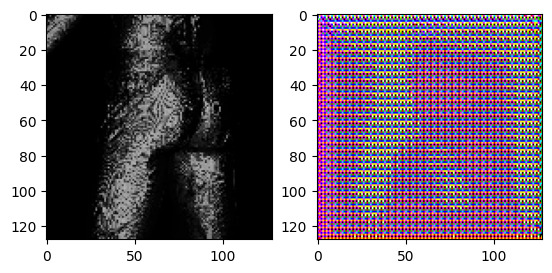

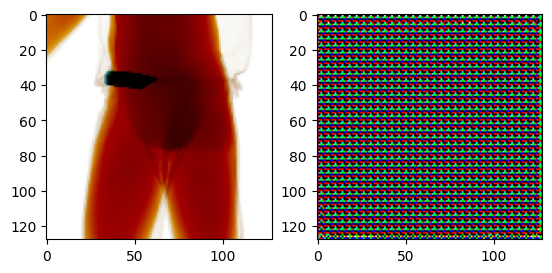

G_loss: 312.52764892578125
D_loss: 7.311429977416992
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


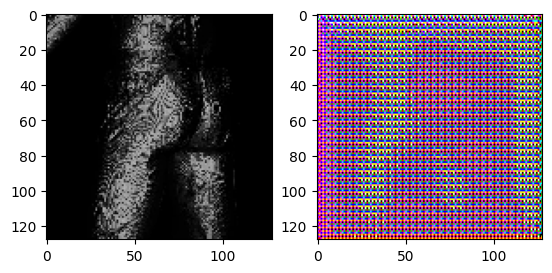

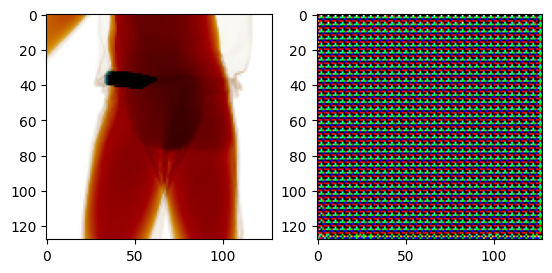

G_loss: 310.0612487792969
D_loss: 7.2894368171691895
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


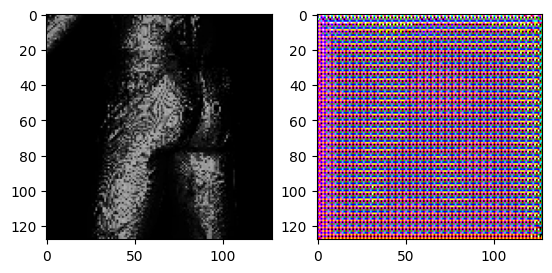

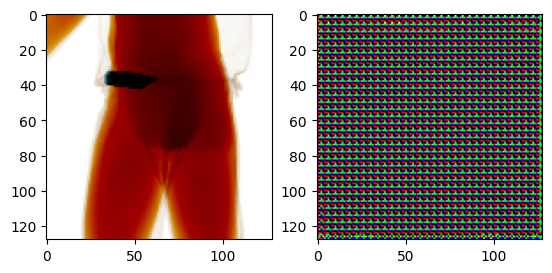

G_loss: 323.2925720214844
D_loss: 7.22439432144165
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


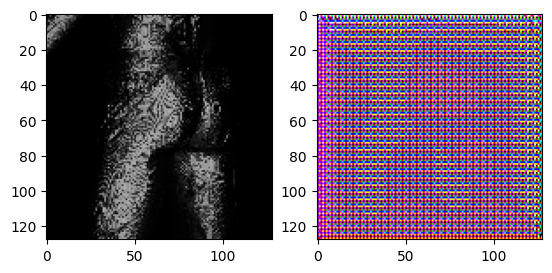

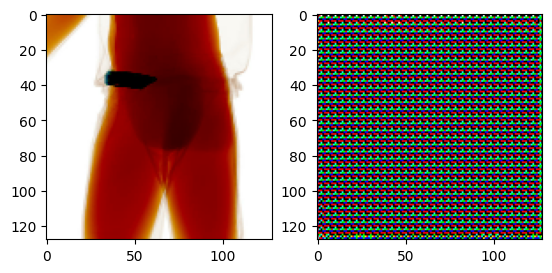

G_loss: 322.78692626953125
D_loss: 7.228449821472168
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


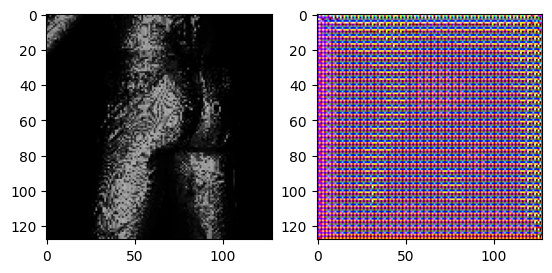

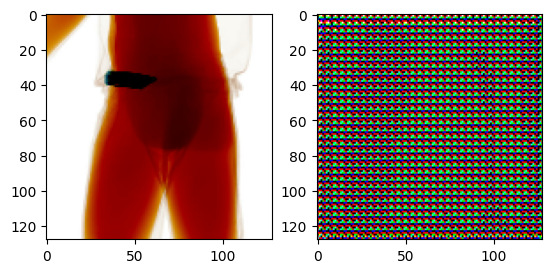

G_loss: 320.11224365234375
D_loss: 7.196942329406738
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


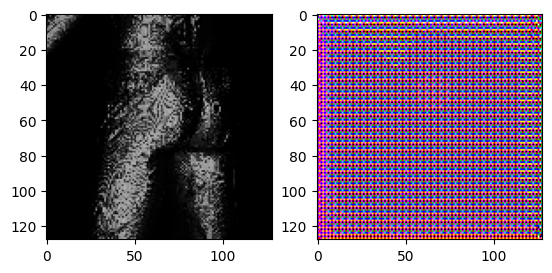

Epoch 1 duration: 12.917067766189575 s


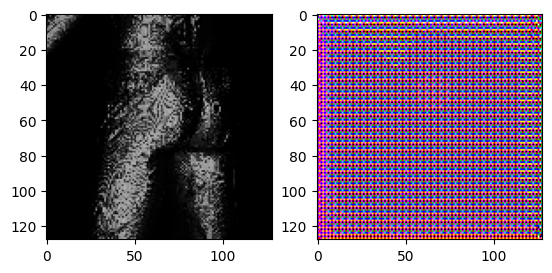

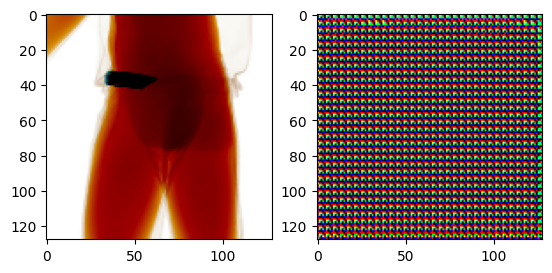

G_loss: 319.97015380859375
D_loss: 7.145157337188721
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


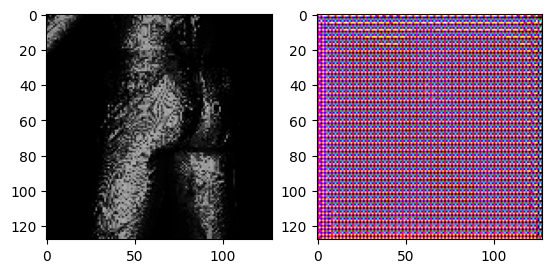

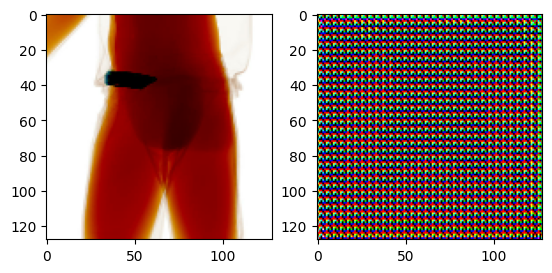

G_loss: 309.0802917480469
D_loss: 7.277270793914795
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


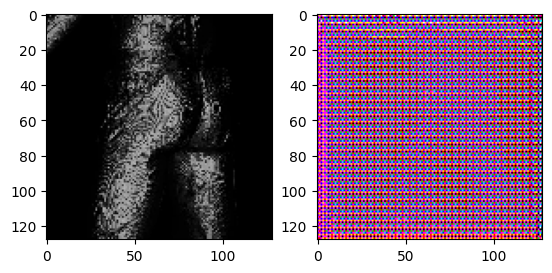

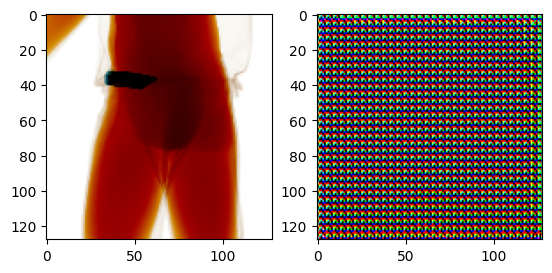

G_loss: 314.5791015625
D_loss: 7.272123336791992
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


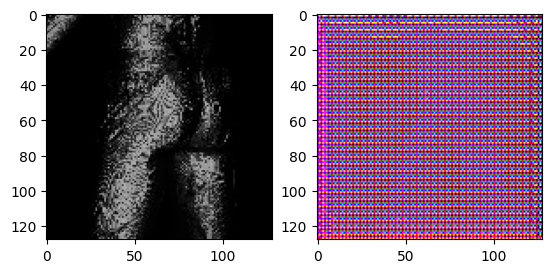

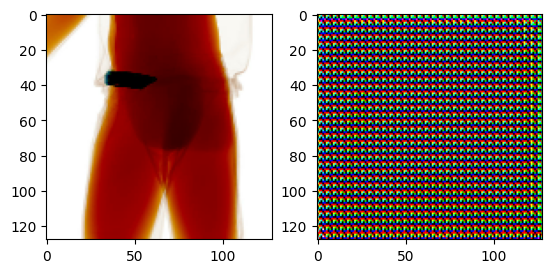

G_loss: 314.8189392089844
D_loss: 7.2700958251953125
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


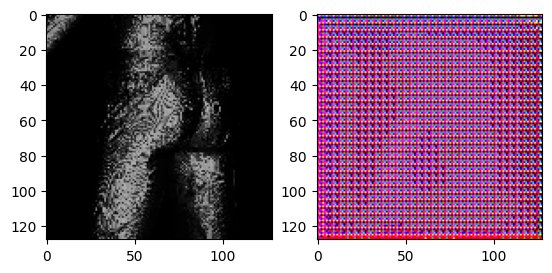

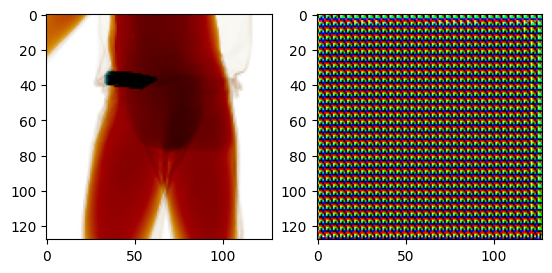

G_loss: 364.94793701171875
D_loss: 7.324064254760742
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


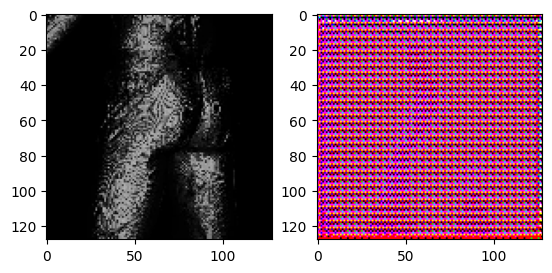

Epoch 2 duration: 12.324538707733154 s


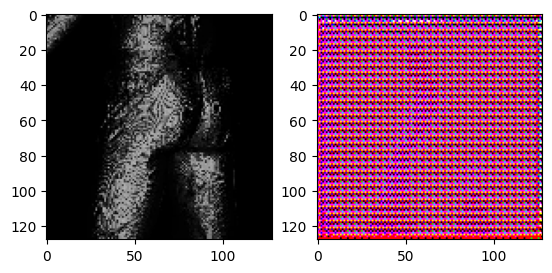

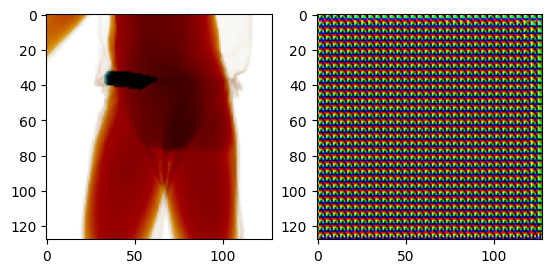

G_loss: 314.858154296875
D_loss: 7.194602966308594
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


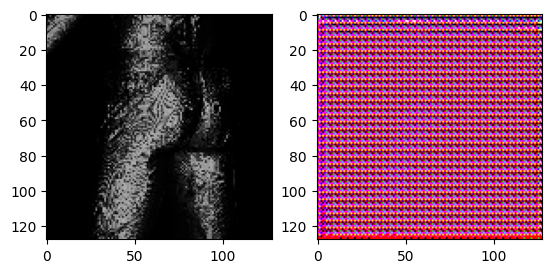

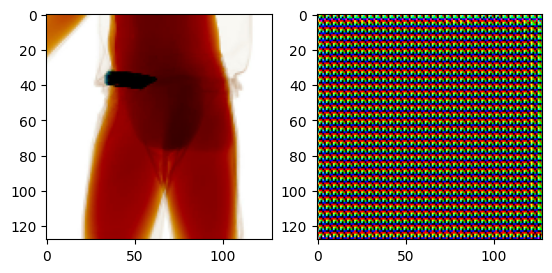

G_loss: 308.935791015625
D_loss: 7.217531204223633
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


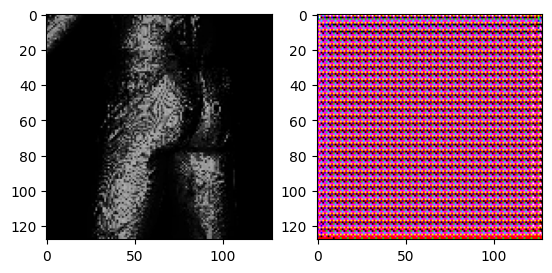

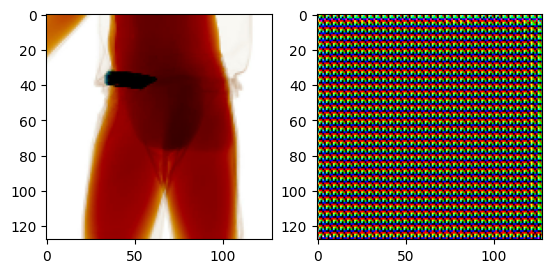

G_loss: 306.85003662109375
D_loss: 7.231725215911865
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


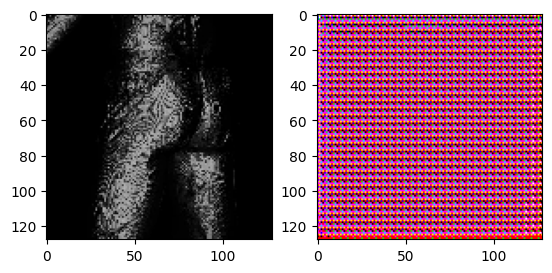

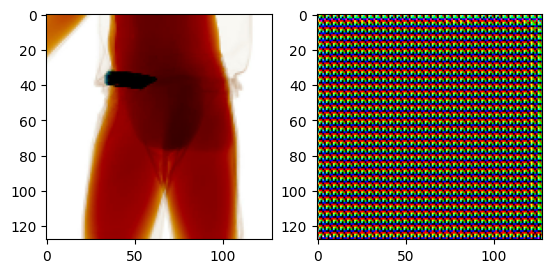

G_loss: 306.07171630859375
D_loss: 7.235780715942383
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


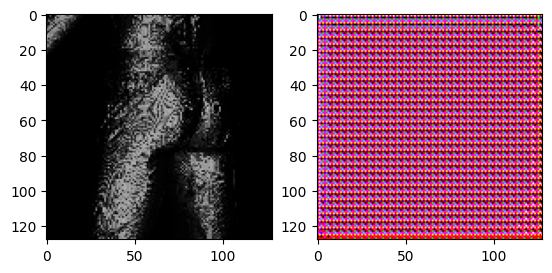

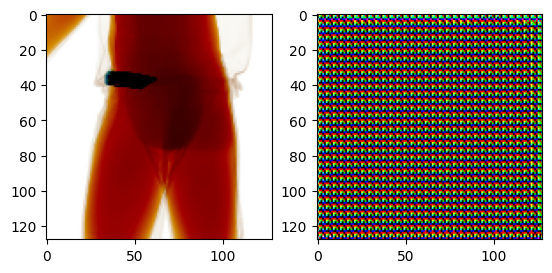

G_loss: 305.0699462890625
D_loss: 7.245763301849365
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


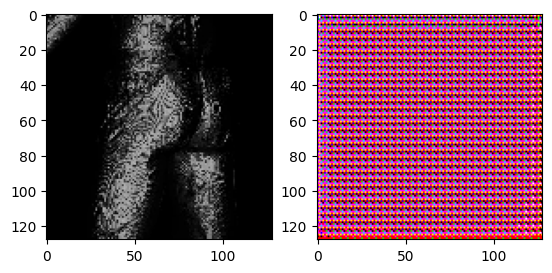

Epoch 3 duration: 12.862614870071411 s


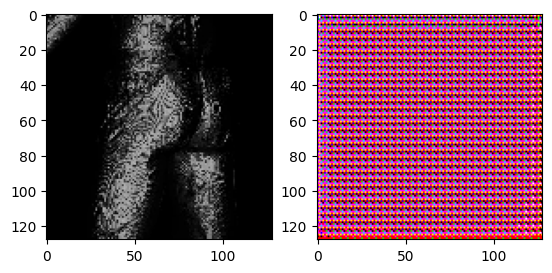

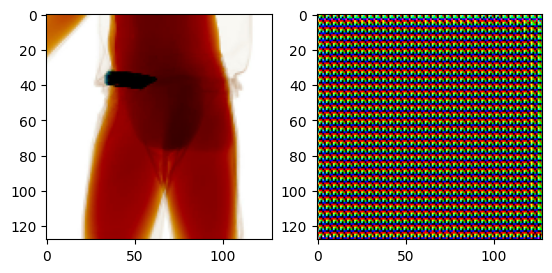

G_loss: 304.9579772949219
D_loss: 7.24607515335083
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


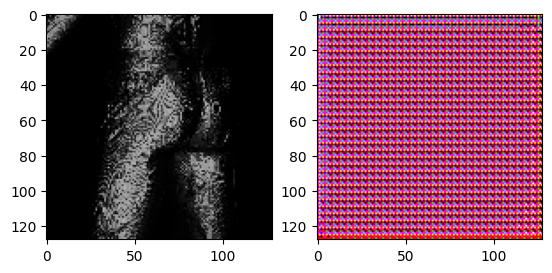

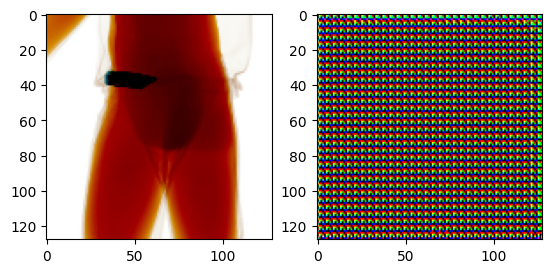

G_loss: 305.0626525878906
D_loss: 7.24607515335083
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


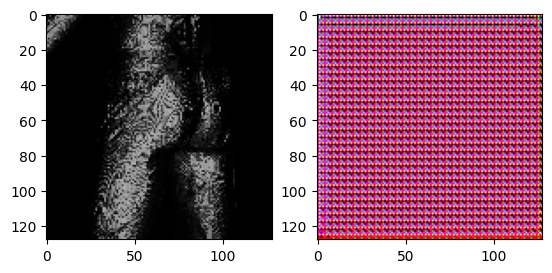

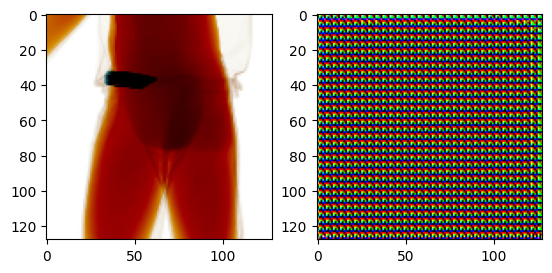

G_loss: 309.69635009765625
D_loss: 7.236560821533203
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


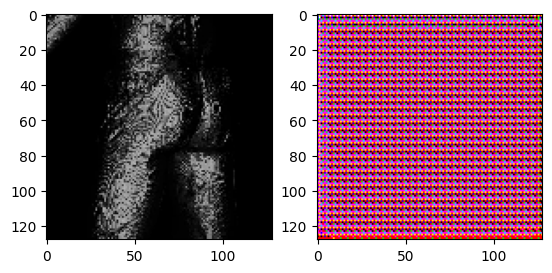

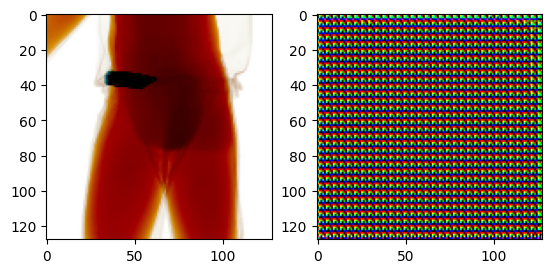

G_loss: 310.0591735839844
D_loss: 7.2350006103515625
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


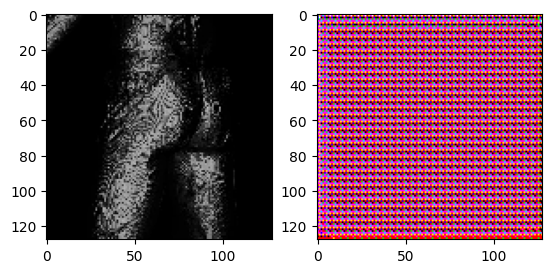

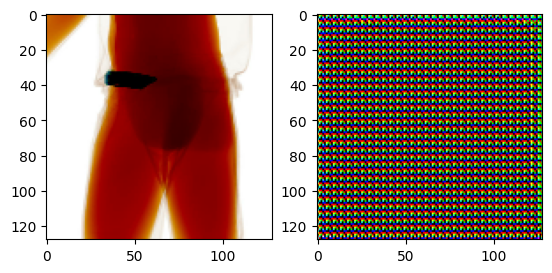

G_loss: 310.00469970703125
D_loss: 7.234532833099365
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


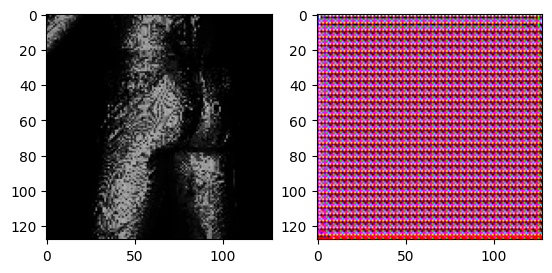

Epoch 4 duration: 12.691620349884033 s


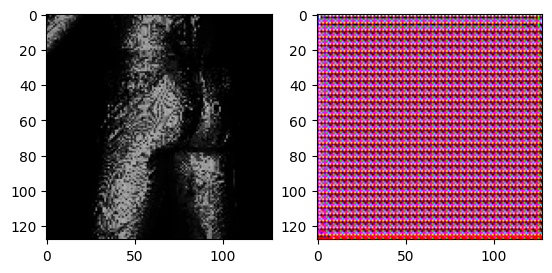

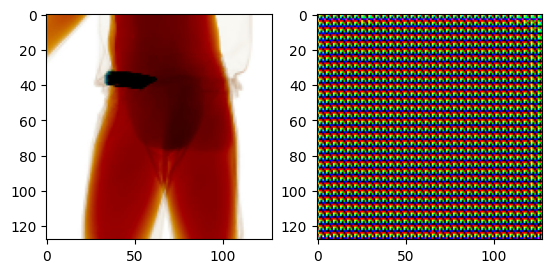

G_loss: 309.9413757324219
D_loss: 7.234688758850098
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


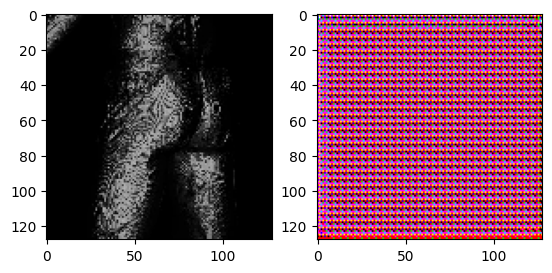

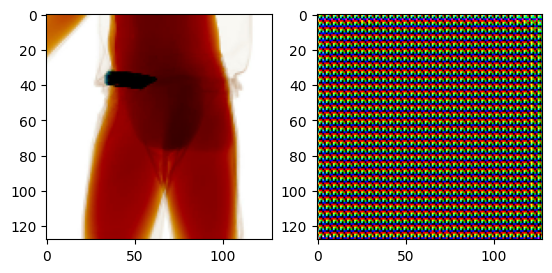

G_loss: 310.14422607421875
D_loss: 7.234376907348633
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


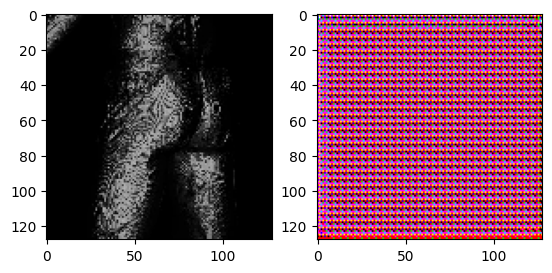

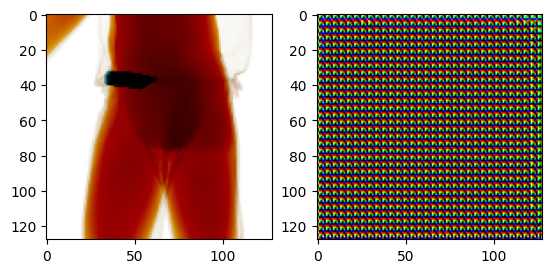

G_loss: 310.14422607421875
D_loss: 7.234376907348633
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


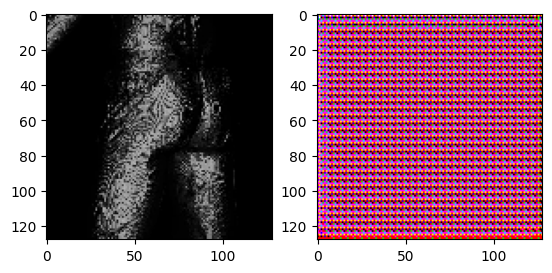

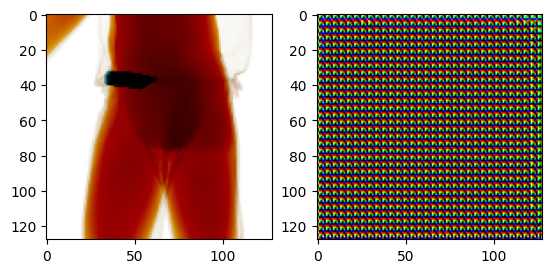

G_loss: 310.14422607421875
D_loss: 7.234376907348633
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


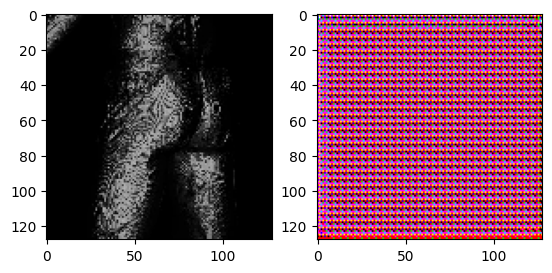

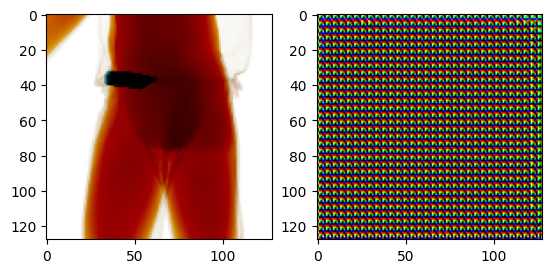

G_loss: 310.14422607421875
D_loss: 7.234376907348633
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


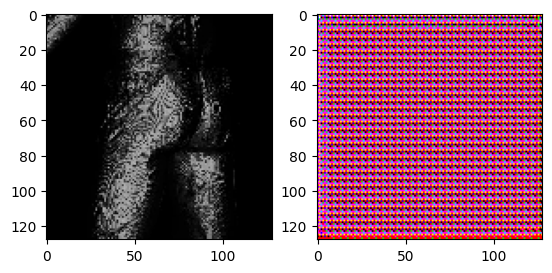

Epoch 5 duration: 12.987939834594727 s


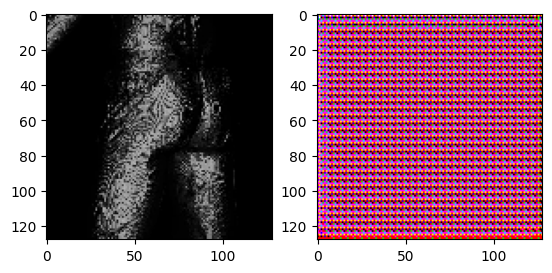

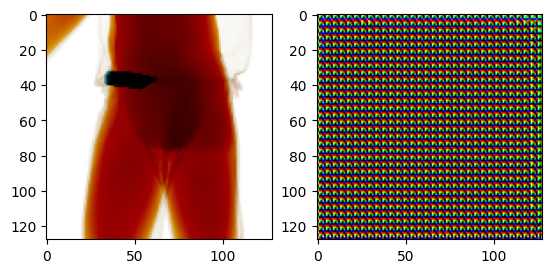

G_loss: 310.14422607421875
D_loss: 7.234376907348633
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


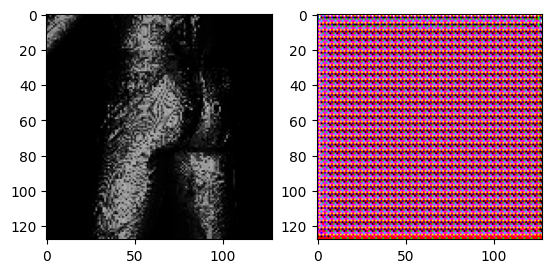

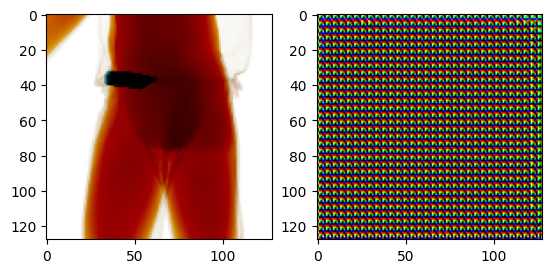

G_loss: 309.79498291015625
D_loss: 7.234688758850098
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


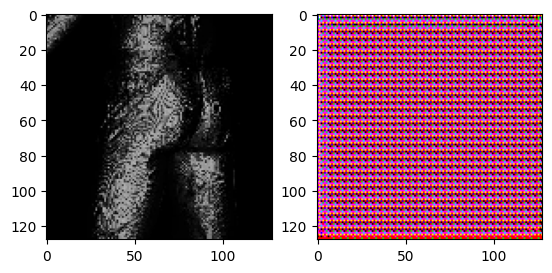

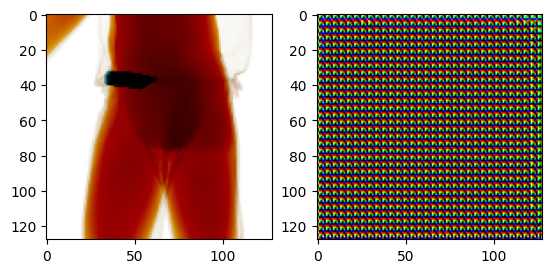

G_loss: 306.8144836425781
D_loss: 7.239680290222168
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


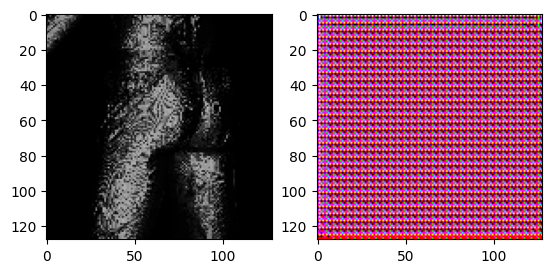

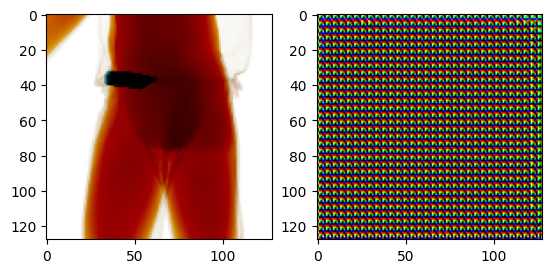

G_loss: 306.694580078125
D_loss: 7.239992141723633
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


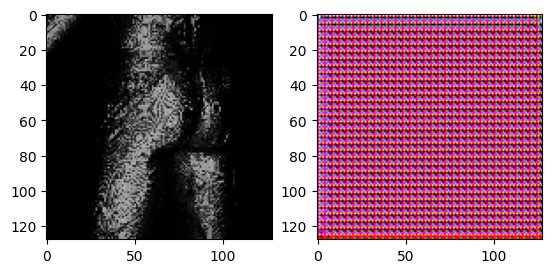

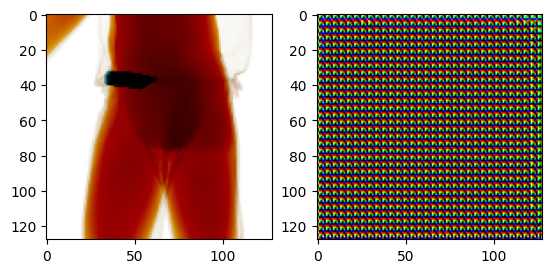

G_loss: 306.3833923339844
D_loss: 7.24045991897583
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


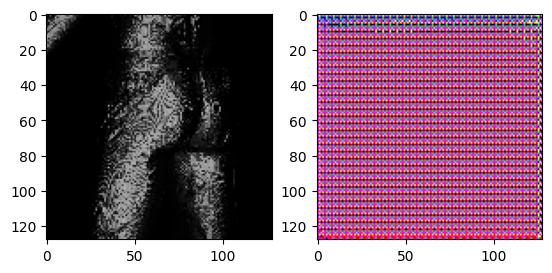

Epoch 6 duration: 13.80619215965271 s


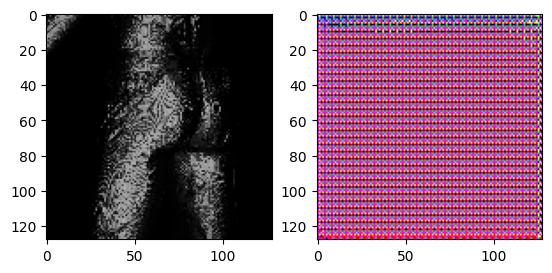

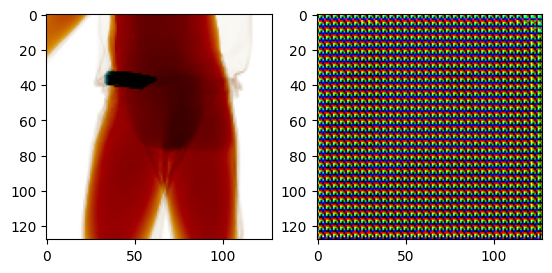

G_loss: 272.1710205078125
D_loss: 7.54243278503418
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


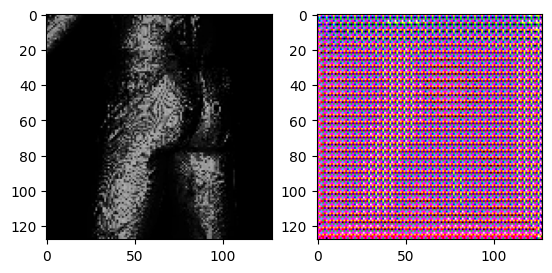

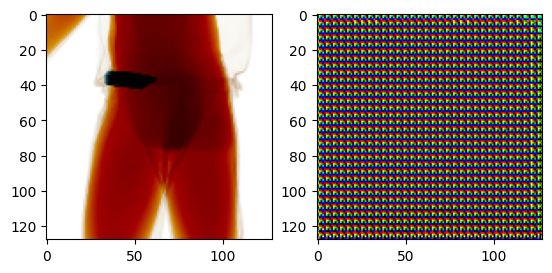

G_loss: 242.4564666748047
D_loss: 7.626816749572754
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


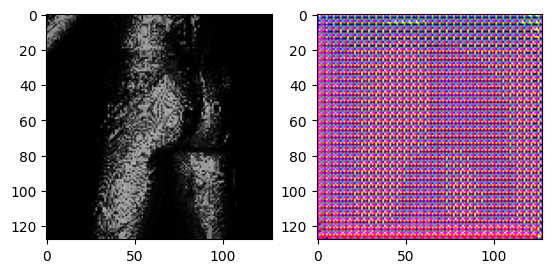

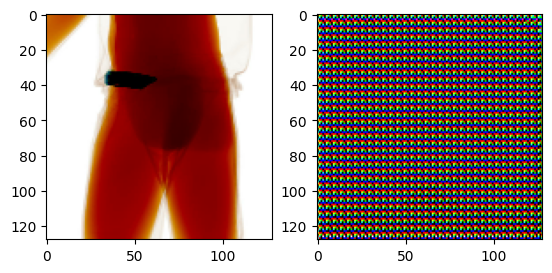

G_loss: 228.5319366455078
D_loss: 7.697319030761719
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


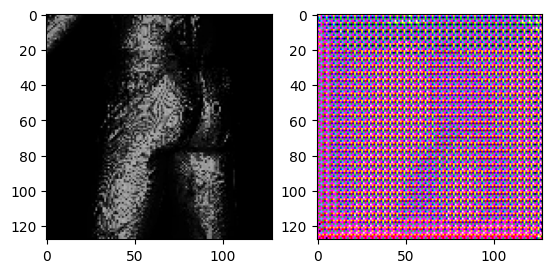

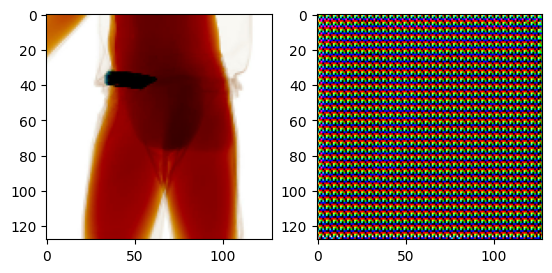

G_loss: 227.3213348388672
D_loss: 7.697162628173828
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


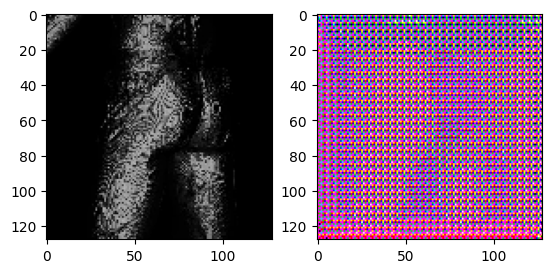

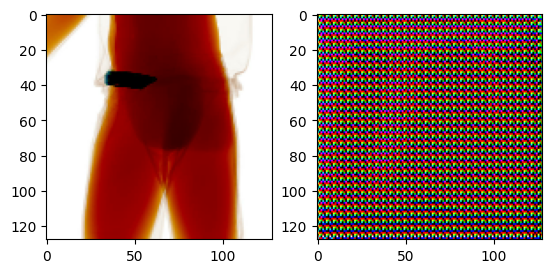

G_loss: 228.15065002441406
D_loss: 7.704182147979736
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


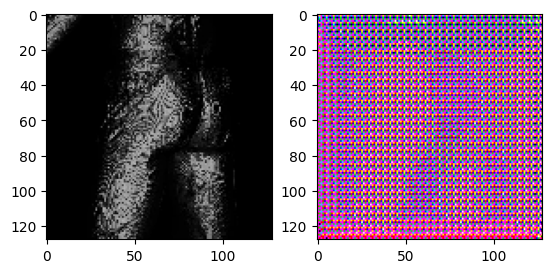

Epoch 7 duration: 13.282946348190308 s


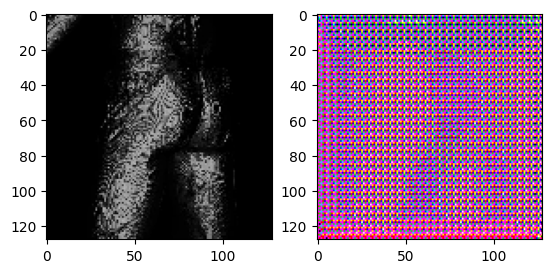

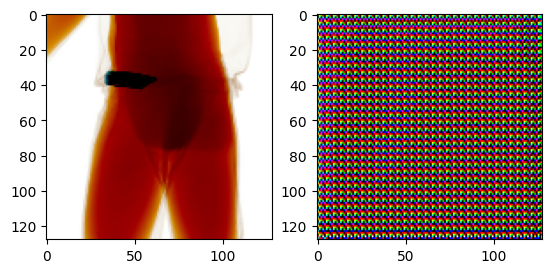

G_loss: 227.7942352294922
D_loss: 7.704649925231934
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


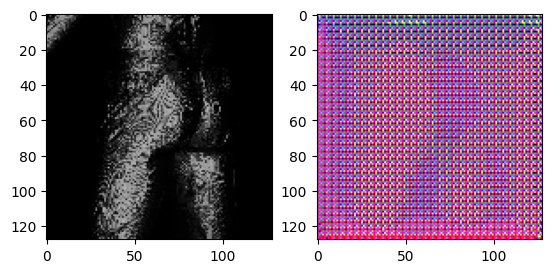

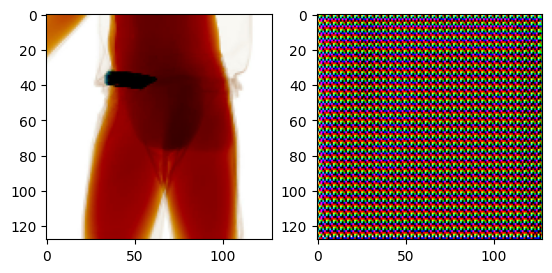

G_loss: 228.00038146972656
D_loss: 7.704649925231934
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


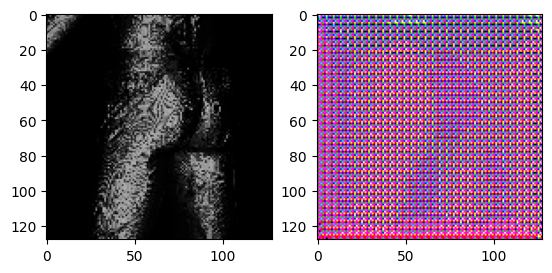

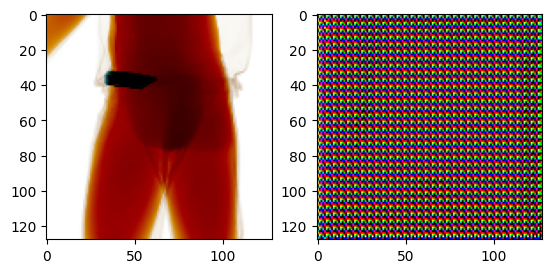

G_loss: 228.2201385498047
D_loss: 7.704338073730469
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


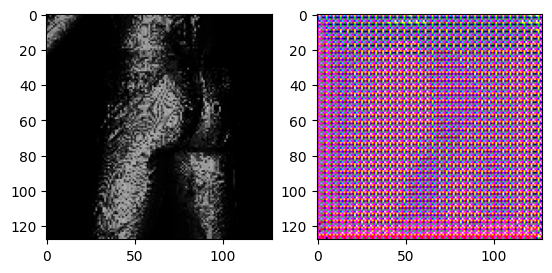

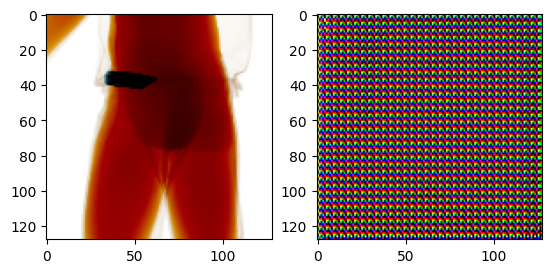

G_loss: 227.30406188964844
D_loss: 7.708081245422363
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


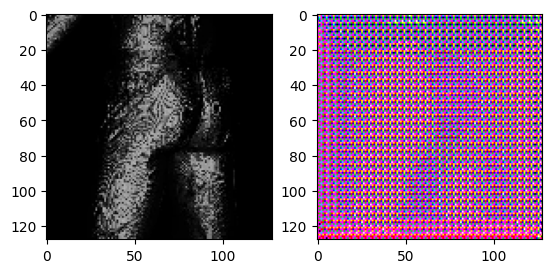

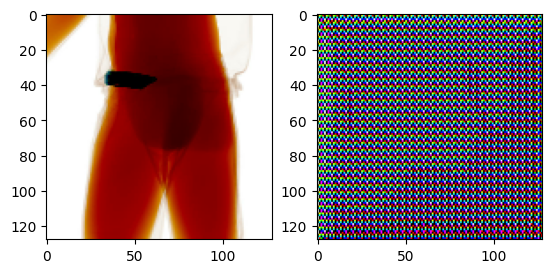

G_loss: 227.27561950683594
D_loss: 7.709173202514648
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


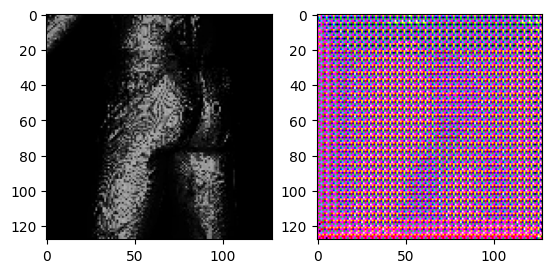

Epoch 8 duration: 13.766758918762207 s


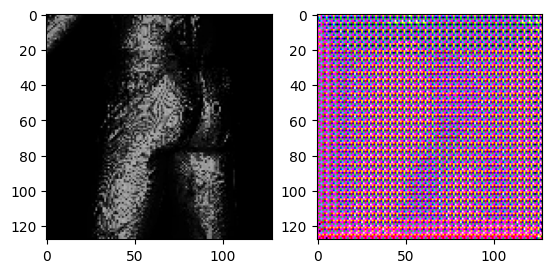

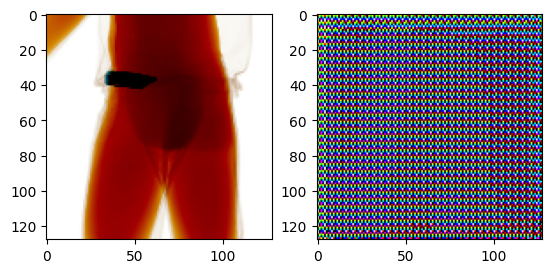

G_loss: 227.36126708984375
D_loss: 7.709485054016113
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


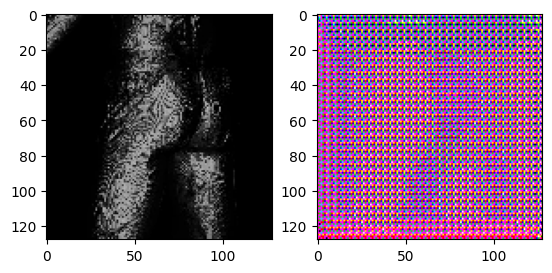

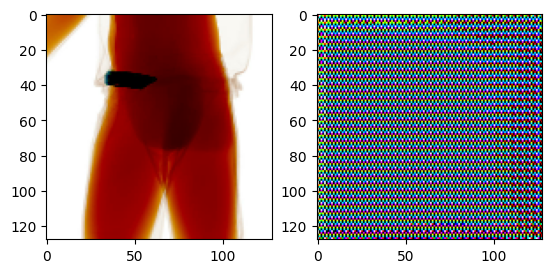

G_loss: 227.36578369140625
D_loss: 7.709173202514648
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


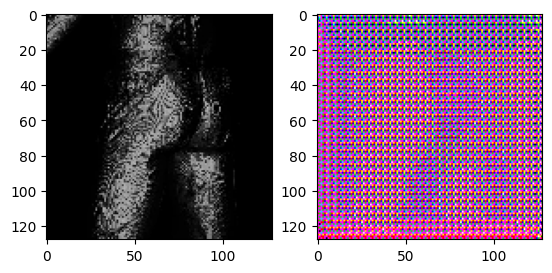

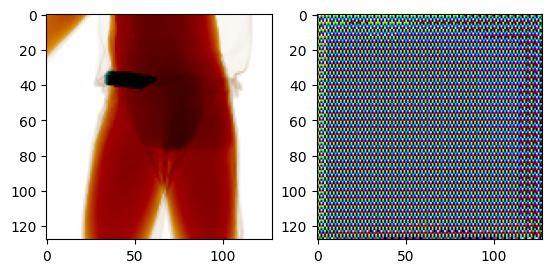

G_loss: 227.36578369140625
D_loss: 7.709173202514648
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


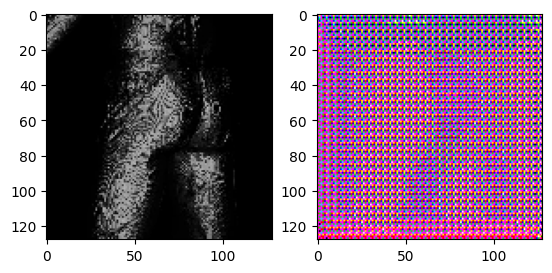

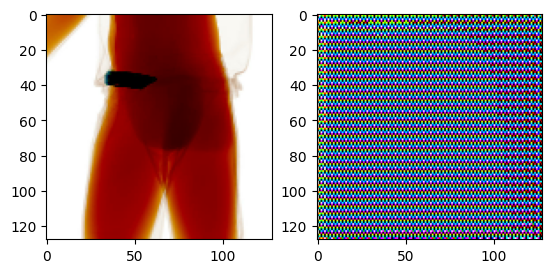

G_loss: 227.36441040039062
D_loss: 7.709329128265381
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


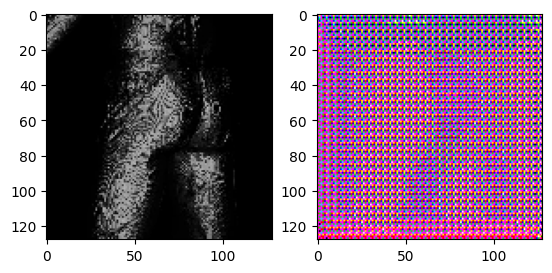

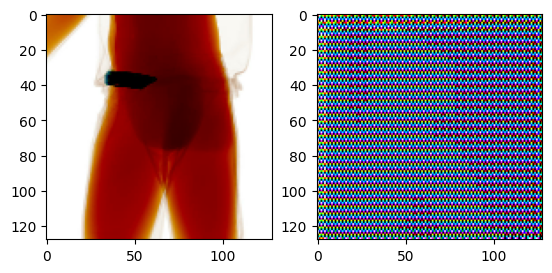

G_loss: 227.36441040039062
D_loss: 7.709329128265381
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


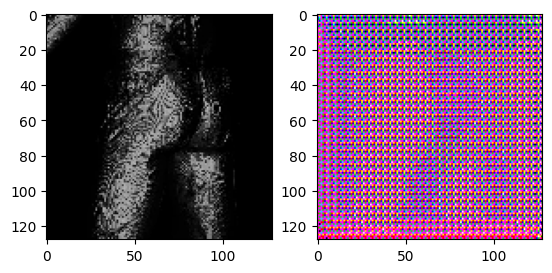

Epoch 9 duration: 13.41553544998169 s


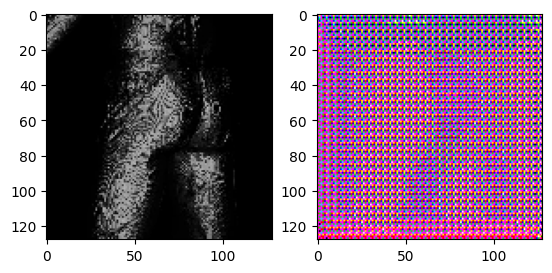

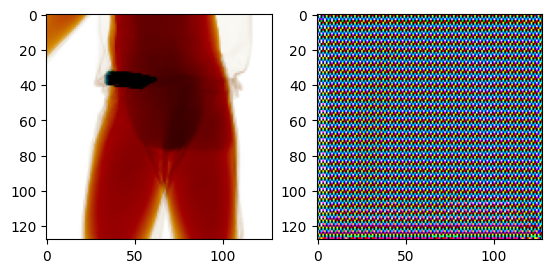

G_loss: 227.36441040039062
D_loss: 7.709329128265381
Image pair 1 complete!
Image pair 2 complete!
Image pair 3 complete!
Image pair 4 complete!
Image pair 5 complete!
Image pair 6 complete!
Image pair 7 complete!
Image pair 8 complete!
Image pair 9 complete!


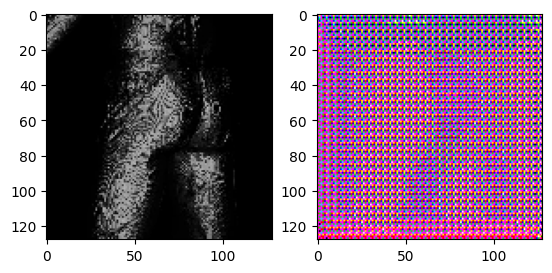

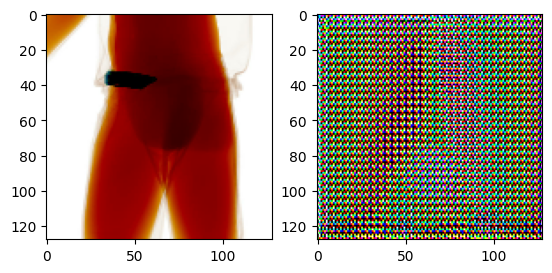

G_loss: 227.36441040039062
D_loss: 7.709329128265381
Image pair 10 complete!
Image pair 11 complete!
Image pair 12 complete!
Image pair 13 complete!
Image pair 14 complete!
Image pair 15 complete!
Image pair 16 complete!
Image pair 17 complete!
Image pair 18 complete!
Image pair 19 complete!


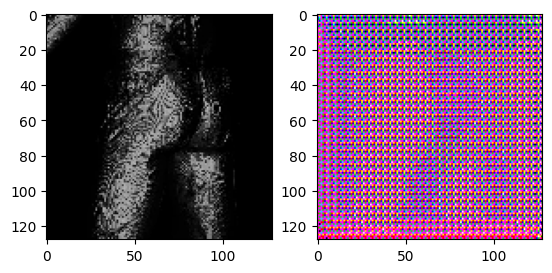

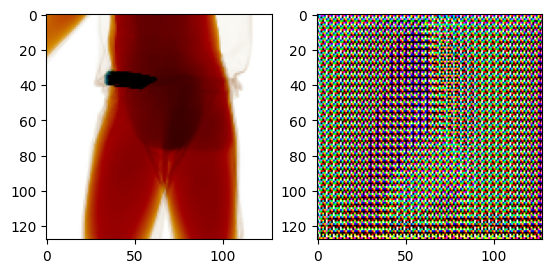

G_loss: 227.36441040039062
D_loss: 7.709329128265381
Image pair 20 complete!
Image pair 21 complete!
Image pair 22 complete!
Image pair 23 complete!
Image pair 24 complete!
Image pair 25 complete!
Image pair 26 complete!
Image pair 27 complete!
Image pair 28 complete!
Image pair 29 complete!


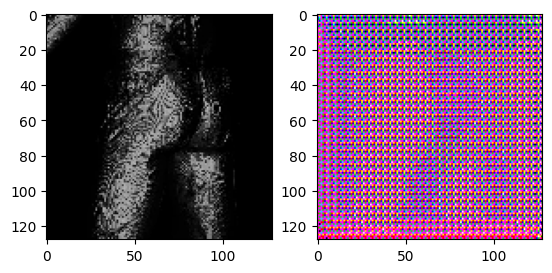

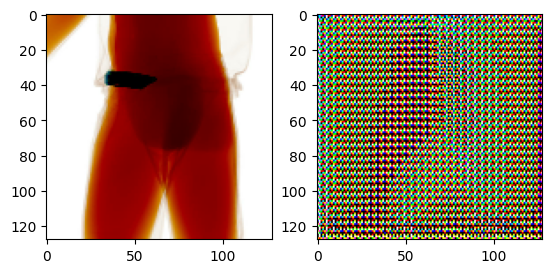

G_loss: 227.36441040039062
D_loss: 7.709329128265381
Image pair 30 complete!
Image pair 31 complete!
Image pair 32 complete!
Image pair 33 complete!
Image pair 34 complete!
Image pair 35 complete!
Image pair 36 complete!
Image pair 37 complete!
Image pair 38 complete!
Image pair 39 complete!


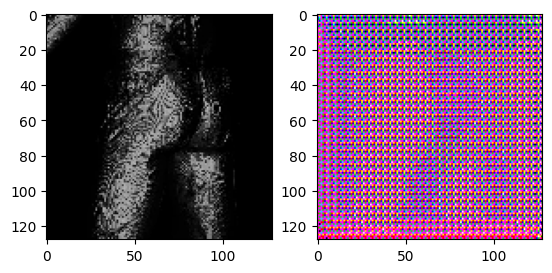

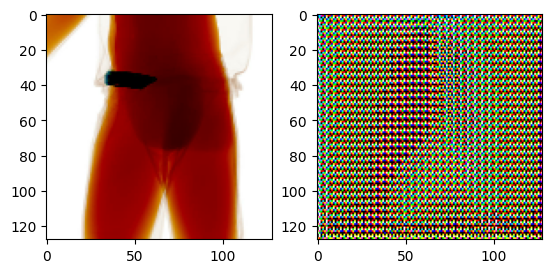

G_loss: 227.36441040039062
D_loss: 7.709329128265381
Image pair 40 complete!
Image pair 41 complete!
Image pair 42 complete!
Image pair 43 complete!
Image pair 44 complete!
Image pair 45 complete!
Image pair 46 complete!
Image pair 47 complete!
Image pair 48 complete!


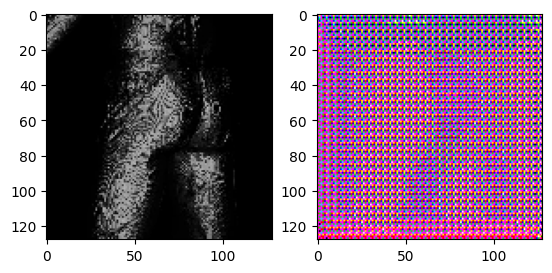

Epoch 10 duration: 15.103253602981567 s


In [ ]:
import time

EPOCHS = 10

G_loss = []
D_loss = []

for i in range(EPOCHS):
  start = time.time()

  img_count = 1

  for x, y in tf.data.Dataset.zip((X_train, Y_train)):
    if img_count % 10 == 0 or img_count == 1:
      generate_image(G, x_1_test)
      generate_image(F, sample_tran)
      G_x = G(x_1_test)
      G_l = generator_loss(D(G_x))
      G_loss.append(G_l)
      D_l = discriminator_loss(y_1_test, G_x)
      D_loss.append(D_l)
      print('G_loss: {}'.format(G_l))
      print('D_loss: {}'.format(D_l))
    train_step(x, y)
    print('Image pair {} complete!'.format(img_count))
    img_count += 1

  generate_image(G, x_1_test)

  end = time.time()
  epoch_duration = end - start

  print('Epoch {} duration: {} s'.format(i+1, epoch_duration))

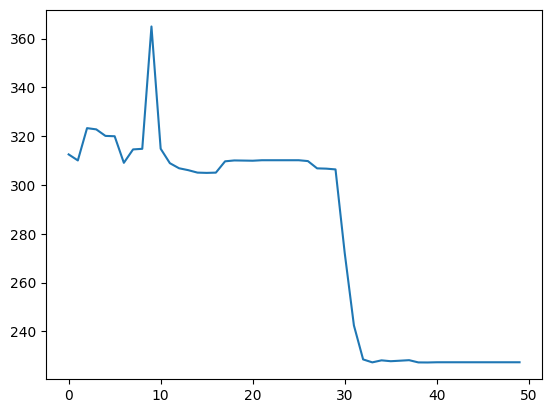

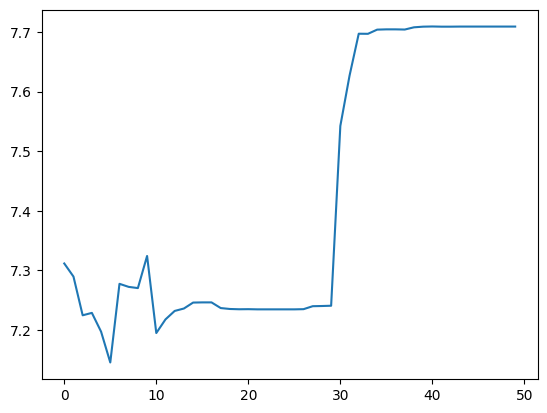

In [ ]:
import numpy as np

index = np.arange(len(G_loss))

plt.plot(index, G_loss)
plt.show()
plt.plot(index, D_loss)